In [1]:
# Enable plots in the notebook
%matplotlib inline
import matplotlib.pyplot as plt

# Seaborn makes our plots prettier
import seaborn
seaborn.set(style = 'ticks')

# Import the audio playback widget
from IPython.display import Audio

import numpy as np
import pandas as pd
import librosa
import librosa.display

In [2]:
# Load example file
y, sr = librosa.load(r'/Users/chiwang/Documents/iTunes 20160601 copy/iTunes Media/Music/Various Artists/Remixed With Love By Joey Negro Vol 2/16 - Norman Connors - Stella (Joey Negro Jazz Ride).mp3')

In [3]:
# Play audio using jupyter audio widget
Audio(data = y, rate = sr)

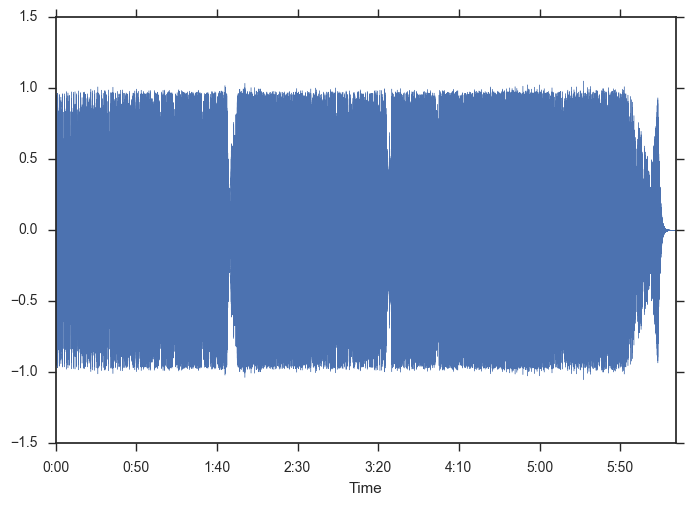

In [4]:
# Display waveform of song
librosa.display.waveplot(y, sr)

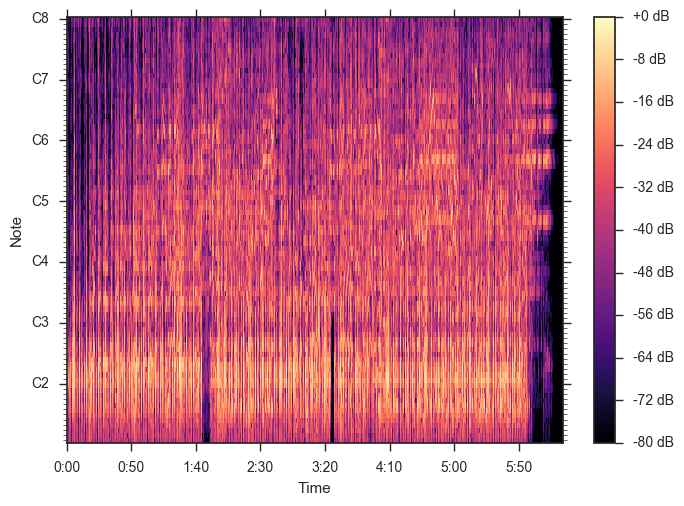

In [5]:
# Calculate short-time Fourier transform
example_cqt = librosa.cqt(y)

# Plot spectrogram
librosa.display.specshow(librosa.amplitude_to_db(example_cqt, ref = np.max), x_axis = 'time', y_axis = 'cqt_note')
plt.colorbar(format='%+2.0f dB')

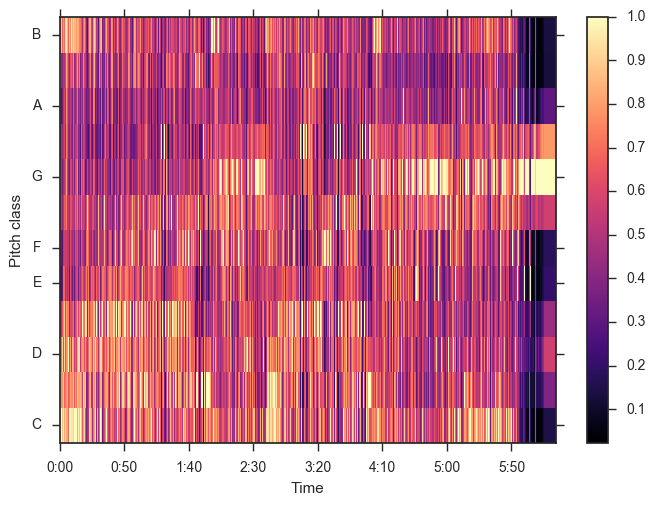

In [7]:
# Calculate the condensed chroma CQT
example_chroma_cqt = librosa.feature.chroma_cqt(y=y, sr=sr)

# Extract tempo and beat
tempo, beat_f = librosa.beat.beat_track(y = y, sr = sr, trim = False)
beat_f = librosa.util.fix_frames(beat_f, x_max = example_chroma_cqt.shape[1])

# Sync CQT w/ beat
example_cqt_sync = librosa.util.sync(example_chroma_cqt, beat_f, aggregate = np.median)
beat_t = librosa.frames_to_time(beat_f, sr = sr)

# Plot chromagram
librosa.display.specshow(example_cqt_sync, y_axis = 'chroma', x_axis = 'time', x_coords=beat_t)
plt.colorbar()

In [11]:
tempo

107.666015625

In [9]:
mfcc = librosa.feature.mfcc(y = y, n_mfcc = 200)

In [18]:
float(len(y))/float(22050)/float(60)

6.4046878306878305